<a href="https://colab.research.google.com/github/irfanulkabirhira/Predict-Credit_Mix-category-from-financial-data-and-offer-insights-to-improve-credit-health/blob/main/Predicting_Customer_Credit_Mix_End_to_End_Machine_Learning_Workflow_checkpoint.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Predict the Credit_Mix category for a customer based on their financial data, and provide actionable insights to improve credit health.

In [ ]:
import pandas as pd

In [ ]:
# url = 'https://raw.githubusercontent.com/rashakil-ds/Public-Datasets/refs/heads/main/Bank%20Data.csv'
df = pd.read_csv('Bank Data.csv')
df.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,...,2022.0,Good,809.98,35.030402,22 Years and 9 Months,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.053114,22 Years and 10 Months,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,...,4.0,Good,809.98,33.811894,NaN,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24_,821-00-0265,Scientist,19114.12,NaN,3,...,4.0,Good,809.98,32.430559,23 Years and 0 Months,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,_______,34847.84,3037.986667,2,...,5.0,Good,605.03,25.926822,27 Years and 3 Months,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


In [ ]:
df.columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'Age', 'SSN', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Credit_Mix', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance'],
      dtype='object')

# Project Workflow

In order to do this project, must follow this structure....

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder
from sklearn.impute import SimpleImputer

# 1. Data Preprocessing
- Handle missing and invalid values in the dataset.
- Encode categorical variables appropriately.
- Scale and normalize numeric features for uniformity.
- Detect and address outliers to improve model stability.

## => Handle Missing and Invalid Values

### Identify missing values

In [ ]:
print("Missing Values Per Column:")
print(df.isnull().sum())

Missing Values Per Column:
ID                             0
Customer_ID                    0
Month                          0
Name                        5015
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary       7498
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                5704
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit           0
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age          4470
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              562
dtype: int64


### Drop duplicates (if any)


In [ ]:
df = df.drop_duplicates()

### Replace invalid placeholders (like underscores or "NA") with NaN

In [ ]:
df.replace(["_", "NA"], np.nan, inplace=True)

### Fill missing values for numeric columns with the mean

In [ ]:
num_imputer = SimpleImputer(strategy="mean")
numeric_cols = df.select_dtypes(include=["float64", "int64"]).columns
df[numeric_cols] = num_imputer.fit_transform(df[numeric_cols])

### Fill missing values for categorical columns with the most frequent value

In [ ]:
cat_imputer = SimpleImputer(strategy="most_frequent")
categorical_cols = df.select_dtypes(include=["object"]).columns
df[categorical_cols] = cat_imputer.fit_transform(df[categorical_cols])

## => Encode Categorical Variables

### Using Label Encoding for simplicity

In [ ]:
label_encoder = LabelEncoder()
for col in categorical_cols:
    df[col] = label_encoder.fit_transform(df[col])

## => Scale and Normalize Numeric Features

### Normalize numeric columns (using MinMaxScaler)

In [ ]:
scaler = MinMaxScaler()
df[numeric_cols] = scaler.fit_transform(df[numeric_cols])

## => Detect and Address Outliers

### Using IQR (Interquartile Range) method to identify and cap outliers

In [ ]:
for col in numeric_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

### Capping outliers

In [ ]:
df[col] = np.where(df[col] < lower_bound, lower_bound, df[col])
df[col] = np.where(df[col] > upper_bound, upper_bound, df[col])

### Final Dataset after Preprocessing

In [ ]:
print("\nPreprocessed Data:")
print(df.head())


Preprocessed Data:
     ID  Customer_ID  Month  Name  Age    SSN  Occupation  Annual_Income  \
0  8246        12320      3    84  156  10205          12           5060   
1  8251        12320      2    84  171  10205          12           5060   
2  8258        12320      1    84  171  10205          12           5060   
3  8265        12320      0    84  183  10205          12           5060   
4  8314         1066      3  7491  225     53          15           8715   

   Monthly_Inhand_Salary  Num_Bank_Accounts  ...  Num_Credit_Inquiries  \
0               0.102087           0.002223  ...              0.779792   
1               0.102087           0.002223  ...              0.001543   
2               0.102087           0.002223  ...              0.001543   
3               0.260275           0.002223  ...              0.001543   
4               0.183501           0.001668  ...              0.001928   

   Credit_Mix  Outstanding_Debt  Credit_Utilization_Ratio  Credit_History_Age 

### Save the cleaned dataset for further use

In [ ]:
df.to_csv("preprocessed_data.csv", index=False)
print("\nPreprocessed dataset saved as 'preprocessed_data.csv'.")


Preprocessed dataset saved as 'preprocessed_data.csv'.


## 2. Exploratory Data Analysis (EDA)
- Perform descriptive statistics to understand the data distribution.
- Visualize relationships between features and the target variable.
- Analyze correlations and identify trends or anomalies in the data.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### => Descriptive Statistics

In [ ]:
print("Descriptive Statistics:")
print(df.describe())

Descriptive Statistics:
                 ID   Customer_ID         Month          Name           Age  \
count  50000.000000  50000.000000  50000.000000  50000.000000  50000.000000   
mean   24999.500000   6249.500000      1.500000   5445.156000    310.578660   
std    14433.901067   3608.475256      1.118045   2970.426429    155.471927   
min        0.000000      0.000000      0.000000      0.000000      0.000000   
25%    12499.750000   3124.750000      0.750000   2857.000000    184.000000   
50%    24999.500000   6249.500000      1.500000   5630.000000    307.000000   
75%    37499.250000   9374.250000      2.250000   8443.000000    418.000000   
max    49999.000000  12499.000000      3.000000  10138.000000    975.000000   

                SSN    Occupation  Annual_Income  Monthly_Inhand_Salary  \
count  50000.000000  50000.000000   50000.000000           50000.000000   
mean    5902.219380      7.497380    8087.632600               0.260275   
std     3791.346235      4.629642    46

In [ ]:
# Check data distribution for numeric columns
print("\nData Distribution:")
print(df[numeric_cols].describe())


Data Distribution:
       Monthly_Inhand_Salary  Num_Bank_Accounts  Num_Credit_Card  \
count           50000.000000       50000.000000     50000.000000   
mean                0.260275           0.009916         0.015291   
std                 0.196393           0.064701         0.086267   
min                 0.000000           0.000000         0.000000   
25%                 0.100038           0.002223         0.002668   
50%                 0.237906           0.003891         0.003336   
75%                 0.337919           0.004447         0.004670   
max                 1.000000           1.000000         1.000000   

       Interest_Rate  Delay_from_due_date  Num_Credit_Inquiries  \
count   50000.000000         50000.000000          50000.000000   
mean        0.011689             0.361842              0.011601   
std         0.077889             0.206394              0.075177   
min         0.000000             0.000000              0.000000   
25%         0.001207            

In [ ]:
# Check the distribution of categorical variables
for col in categorical_cols:
    print(f"\nValue Counts for {col}:")
    print(df[col].value_counts())


Value Counts for ID:
ID
8246     1
13708    1
13682    1
13683    1
13684    1
        ..
46702    1
46703    1
46704    1
46705    1
31397    1
Name: count, Length: 50000, dtype: int64

Value Counts for Customer_ID:
Customer_ID
12320    4
9350     4
4935     4
11721    4
3672     4
        ..
1953     4
6950     4
9460     4
11830    4
8833     4
Name: count, Length: 12500, dtype: int64

Value Counts for Month:
Month
3    12500
2    12500
1    12500
0    12500
Name: count, dtype: int64

Value Counts for Name:
Name
8697    5037
4940      21
7351      20
4021      20
7674      20
        ... 
6564       1
255        1
3433       1
7963       1
9094       1
Name: count, Length: 10139, dtype: int64

Value Counts for Age:
Age
383    1493
289    1440
441    1428
144    1422
335    1414
       ... 
435       1
46        1
20        1
190       1
523       1
Name: count, Length: 976, dtype: int64

Value Counts for SSN:
SSN
0        2828
10205       4
9384        4
1154        4
11271       4

### =>Visualize Relationships Between Features and Target

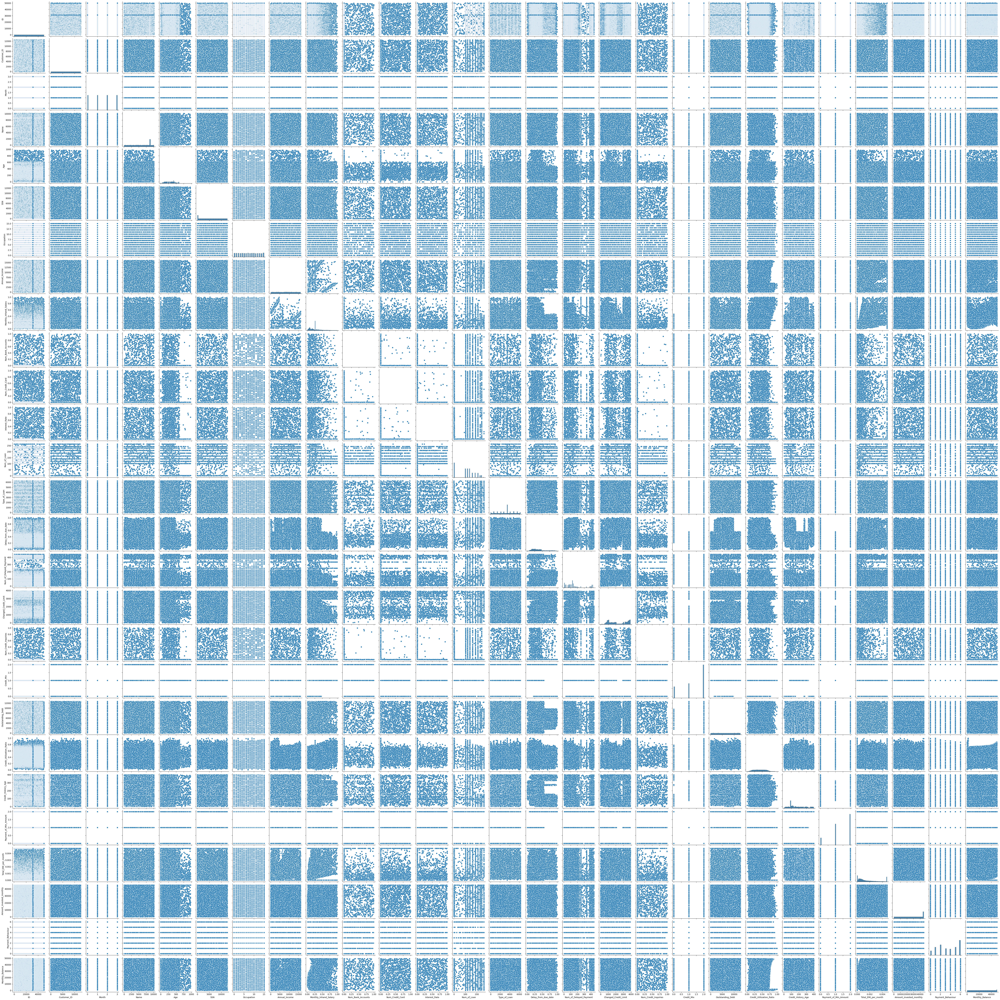

In [ ]:
# Pairplot to visualize relationships (for small datasets)
sns.pairplot(df)
plt.show()

In [ ]:
# Boxplots to check distribution of numeric features by target (replace 'target_column' with your target variable)
if 'target_column' in df.columns:
    for col in numeric_cols:
        plt.figure(figsize=(8, 5))
        sns.boxplot(x=df['target_column'], y=df[col])
        plt.title(f"{col} vs Target")
        plt.show()

### => Correlation Analysis

In [ ]:
# Compute correlation matrix
corr_matrix = df.corr()

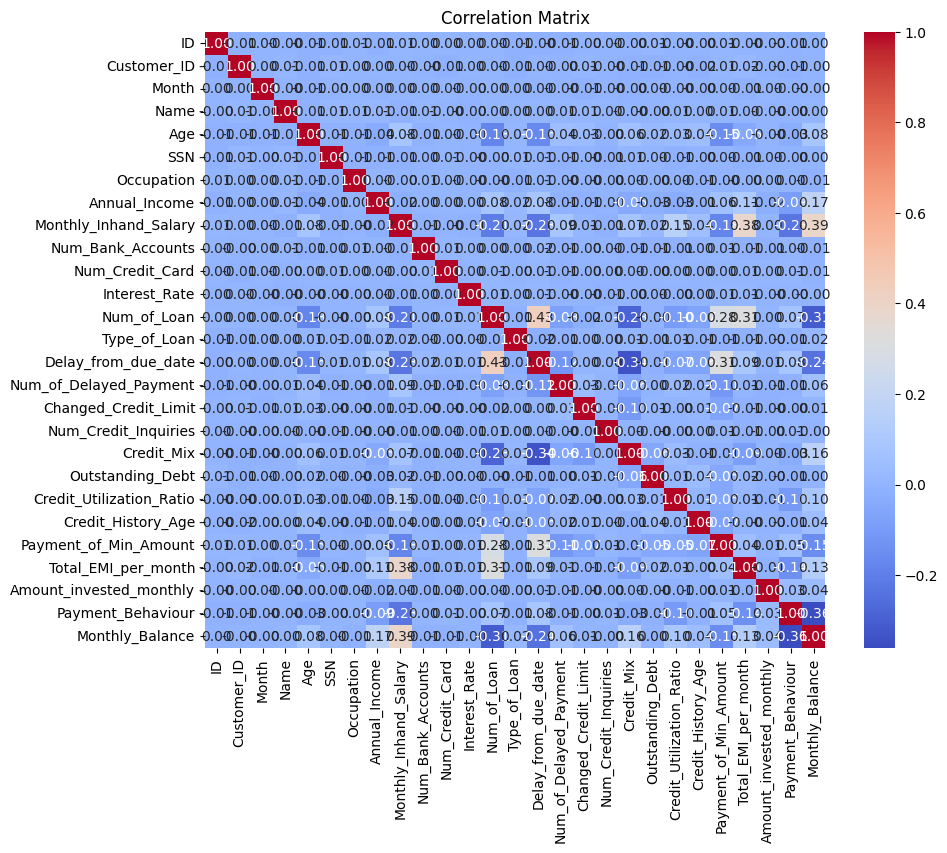

In [ ]:
# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

### =>Analyze trends or anomalies


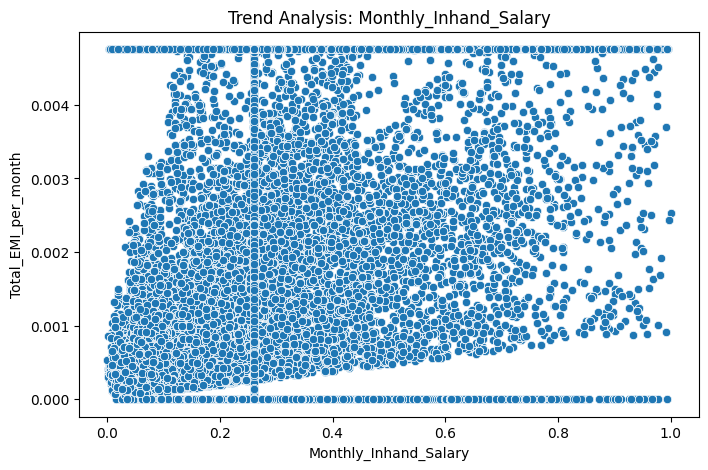

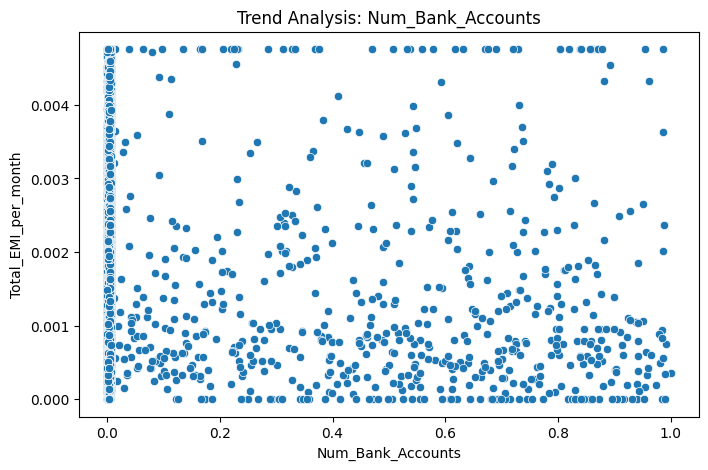

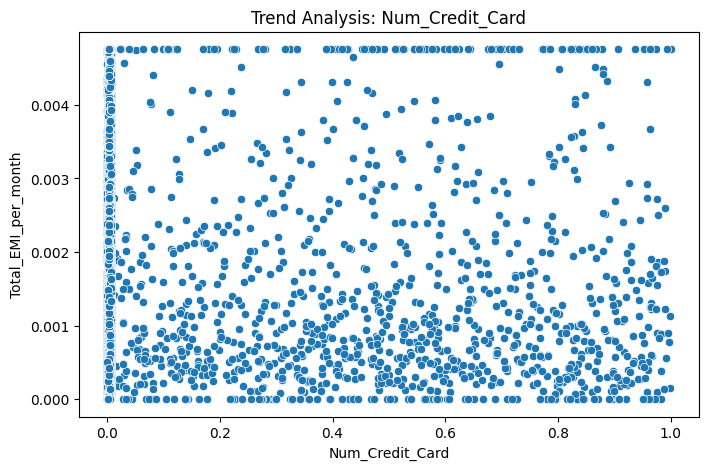

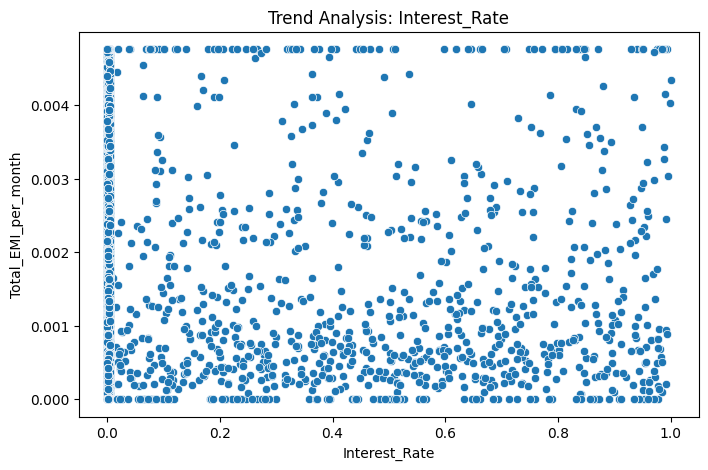

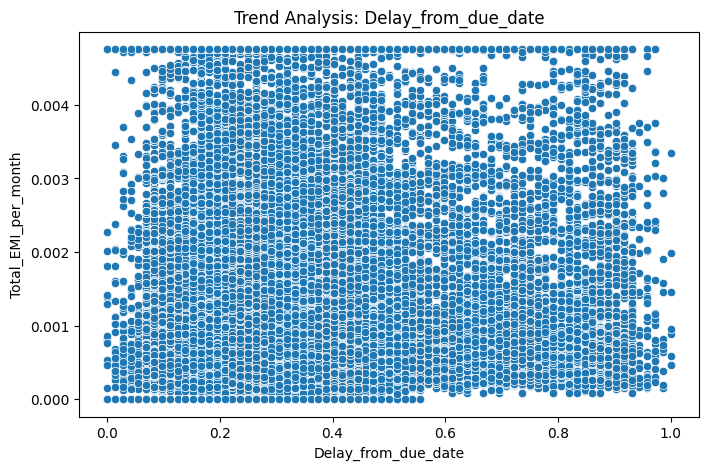

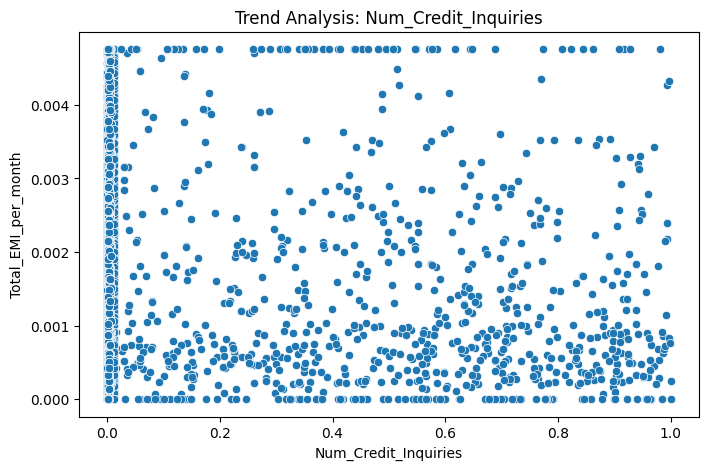

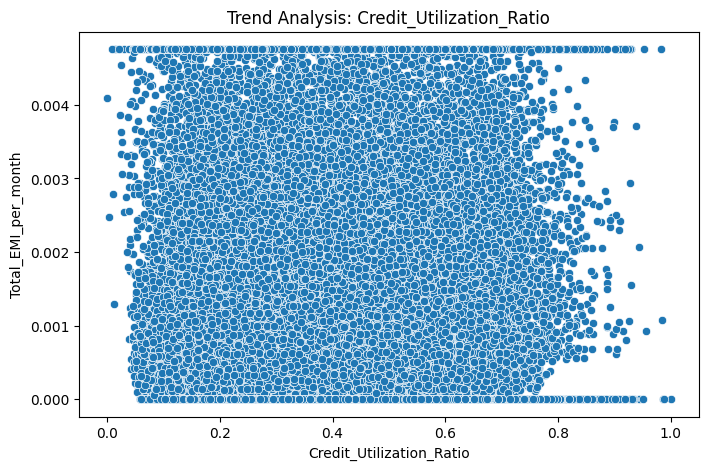

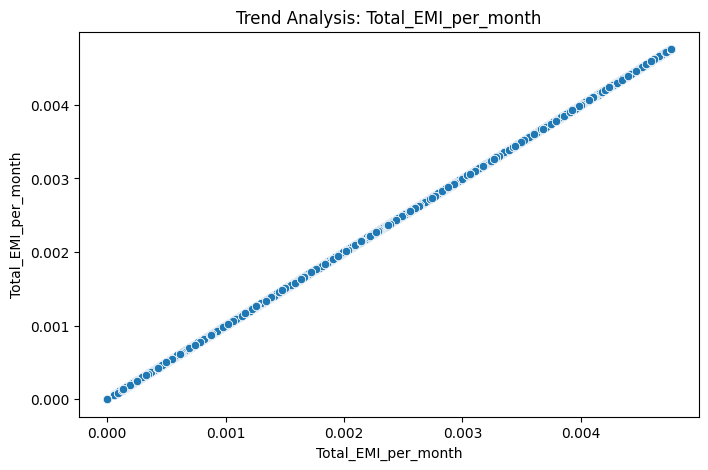

In [ ]:
# Line plots or scatterplots for trend analysis
for col in numeric_cols:
    plt.figure(figsize=(8, 5))
    sns.scatterplot(x=df[col], y=df['target_column'] if 'target_column' in df.columns else df[numeric_cols[-1]])
    plt.title(f"Trend Analysis: {col}")
    plt.xlabel(col)
    plt.ylabel('Target' if 'target_column' in df.columns else numeric_cols[-1])
    plt.show()

## 3. Model Building
- Train multiple machine learning models using the preprocessed data.
- Evaluate the suitability of various models for the task.

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR

In [ ]:
# Define features (X) and target (y)===> i have taken My target is ==> Credit_mix
X = df.drop("Credit_Mix", axis=1)  # Replace 'target_column' with the name of your target variable
y = df["Credit_Mix"]

In [ ]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Initialize models
models = {
    "Linear Regression": LinearRegression(),
    "Random Forest": RandomForestRegressor(random_state=42),
    "Decision Tree": DecisionTreeRegressor(random_state=42),
    "Support Vector Regressor": SVR()
}

In [ ]:
# Train and evaluate each model
results = {}

for model_name, model in models.items():
    print(f"Training {model_name}...")

    # Train the model
    model.fit(X_train, y_train)

    # Make predictions
    y_pred = model.predict(X_test)

    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

Training Linear Regression...
Training Random Forest...
Training Decision Tree...
Training Support Vector Regressor...


In [ ]:
 # Store results
results[model_name] = {"MSE": mse, "R2 Score": r2}

print(f"{model_name} - MSE: {mse:.4f}, R2 Score: {r2:.4f}")

Support Vector Regressor - MSE: 0.7016, R2 Score: -0.1368


In [ ]:
# Display the results
print("\nModel Performance Comparison:")
for model_name, metrics in results.items():
    print(f"{model_name} -> MSE: {metrics['MSE']:.4f}, R2 Score: {metrics['R2 Score']:.4f}")


Model Performance Comparison:
Support Vector Regressor -> MSE: 0.7016, R2 Score: -0.1368


## 4. Model Evaluation
- Compute and plot evaluation metrics for all models, such as accuracy, precision, recall, F1-score, and AUC-ROC.
- Compare the performance of models across multiple metrics.

### Model Evaluation for Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Initialize and fit the Linear Regression model
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

# Make predictions
y_pred_lr = lr_model.predict(X_test)

# Calculate performance metrics
mse_lr = mean_squared_error(y_test, y_pred_lr)
r2_lr = r2_score(y_test, y_pred_lr)

# Display the metrics
print("Linear Regression Model Evaluation:")
print(f"Mean Squared Error (MSE): {mse_lr:.4f}")
print(f"R² Score: {r2_lr:.4f}")


Linear Regression Model Evaluation:
Mean Squared Error (MSE): 0.5042
R² Score: 0.1830


### Model Evaluation for Random Forest

Classes in y_test: [0, 1, 2]
Shape of y_test_binarized: (10000, 3)

Random Forest Model Evaluation:
Accuracy: 0.8622
Precision: 0.8727
Recall: 0.8622
F1 Score: 0.8627
AUC-ROC: 0.9436


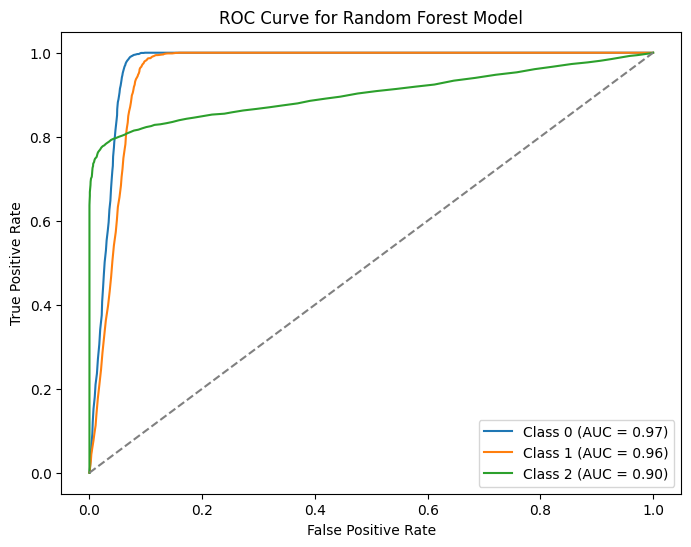

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize

# Initialize and fit the Random Forest model
rf_model = RandomForestClassifier()
rf_model.fit(X_train, y_train)

# Make predictions
y_pred_rf = rf_model.predict(X_test)

# Calculate classification metrics
accuracy_rf = accuracy_score(y_test, y_pred_rf)
precision_rf = precision_score(y_test, y_pred_rf, average='weighted', zero_division=0)
recall_rf = recall_score(y_test, y_pred_rf, average='weighted', zero_division=0)
f1_rf = f1_score(y_test, y_pred_rf, average='weighted', zero_division=0)

# For AUC-ROC, we need probabilities
y_prob_rf = rf_model.predict_proba(X_test)

# Check the unique classes in y_test to ensure correct binarization
classes = sorted(set(y_test))  # Get unique classes in y_test
print(f"Classes in y_test: {classes}")

# Binarize the output labels for multiclass AUC-ROC
y_test_binarized = label_binarize(y_test, classes=classes)
print(f"Shape of y_test_binarized: {y_test_binarized.shape}")

# Calculate AUC-ROC for each class
auc_roc_rf = roc_auc_score(y_test_binarized, y_prob_rf, average='macro', multi_class='ovr')

# Display the metrics
print("\nRandom Forest Model Evaluation:")
print(f"Accuracy: {accuracy_rf:.4f}")
print(f"Precision: {precision_rf:.4f}")
print(f"Recall: {recall_rf:.4f}")
print(f"F1 Score: {f1_rf:.4f}")
print(f"AUC-ROC: {auc_roc_rf:.4f}")

# Plot ROC curve manually for each class
plt.figure(figsize=(8, 6))
for i in range(len(classes)):
    fpr, tpr, _ = roc_curve(y_test_binarized[:, i], y_prob_rf[:, i])
    plt.plot(fpr, tpr, label=f'Class {classes[i]} (AUC = {roc_auc_score(y_test_binarized[:, i], y_prob_rf[:, i]):.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Random Forest Model')
plt.legend(loc='lower right')
plt.show()

### Model Evaluation for Decision Tree

Classes in y_test: [0, 1, 2]
Shape of y_test_binarized: (10000, 3)

Decision Tree Model Evaluation:
Accuracy: 0.7850
Precision: 0.7847
Recall: 0.7850
F1 Score: 0.7847
AUC-ROC: 0.8191


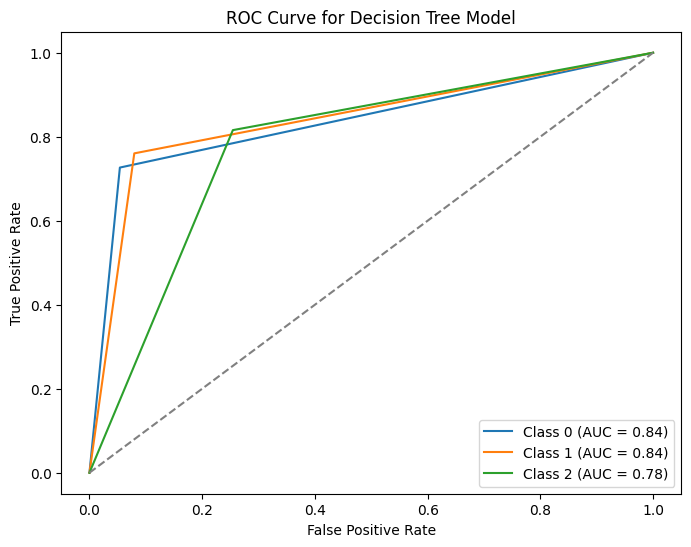

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize

# Initialize and fit the Decision Tree model
dt_model = DecisionTreeClassifier()
dt_model.fit(X_train, y_train)

# Make predictions
y_pred_dt = dt_model.predict(X_test)

# Calculate classification metrics
accuracy_dt = accuracy_score(y_test, y_pred_dt)
precision_dt = precision_score(y_test, y_pred_dt, average='weighted', zero_division=0)
recall_dt = recall_score(y_test, y_pred_dt, average='weighted', zero_division=0)
f1_dt = f1_score(y_test, y_pred_dt, average='weighted', zero_division=0)

# For AUC-ROC, we need probabilities
y_prob_dt = dt_model.predict_proba(X_test)

# Check the unique classes in y_test to ensure correct binarization
classes = sorted(set(y_test))  # Get unique classes in y_test
print(f"Classes in y_test: {classes}")

# Binarize the output labels for multiclass AUC-ROC
y_test_binarized = label_binarize(y_test, classes=classes)
print(f"Shape of y_test_binarized: {y_test_binarized.shape}")

# Calculate AUC-ROC for each class
auc_roc_dt = roc_auc_score(y_test_binarized, y_prob_dt, average='macro', multi_class='ovr')

# Display the metrics
print("\nDecision Tree Model Evaluation:")
print(f"Accuracy: {accuracy_dt:.4f}")
print(f"Precision: {precision_dt:.4f}")
print(f"Recall: {recall_dt:.4f}")
print(f"F1 Score: {f1_dt:.4f}")
print(f"AUC-ROC: {auc_roc_dt:.4f}")

# Plot ROC curve manually for each class
plt.figure(figsize=(8, 6))
for i in range(len(classes)):
    fpr, tpr, _ = roc_curve(y_test_binarized[:, i], y_prob_dt[:, i])
    plt.plot(fpr, tpr, label=f'Class {classes[i]} (AUC = {roc_auc_score(y_test_binarized[:, i], y_prob_dt[:, i]):.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Decision Tree Model')
plt.legend(loc='lower right')
plt.show()

### Model Evaluation for Support Vector Machine (SVM)

Classes in y_test: [0, 1, 2]
Shape of y_test_binarized: (10000, 3)

SVM Model Evaluation:
Accuracy: 0.5620
Precision: 0.3984
Recall: 0.5620
F1 Score: 0.4062
AUC-ROC: 0.7496


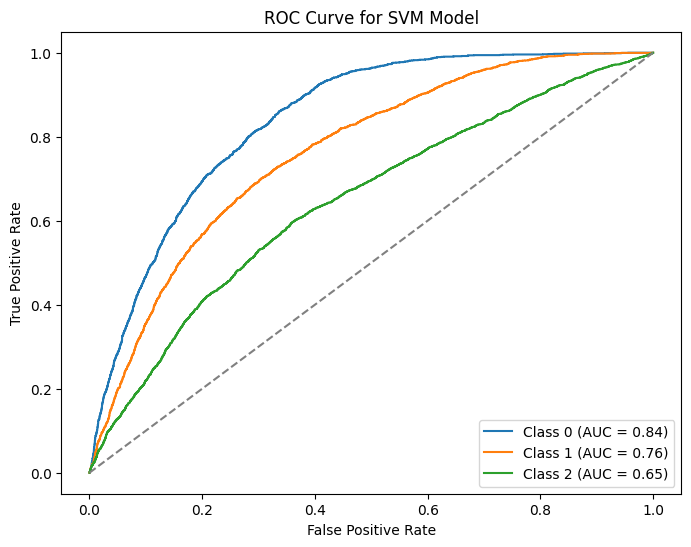

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize

# Initialize and fit the Support Vector Machine model
svm_model = SVC(probability=True)
svm_model.fit(X_train, y_train)

# Make predictions
y_pred_svm = svm_model.predict(X_test)

# Calculate classification metrics
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm, average='weighted', zero_division=0)
recall_svm = recall_score(y_test, y_pred_svm, average='weighted', zero_division=0)
f1_svm = f1_score(y_test, y_pred_svm, average='weighted', zero_division=0)

# For AUC-ROC, we need probabilities
y_prob_svm = svm_model.predict_proba(X_test)

# Check the unique classes in y_test to ensure correct binarization
classes = sorted(set(y_test))  # Get unique classes in y_test
print(f"Classes in y_test: {classes}")

# Binarize the output labels for multiclass AUC-ROC
y_test_binarized = label_binarize(y_test, classes=classes)
print(f"Shape of y_test_binarized: {y_test_binarized.shape}")

# Calculate AUC-ROC for each class
auc_roc_svm = roc_auc_score(y_test_binarized, y_prob_svm, average='macro', multi_class='ovr')

# Display the metrics
print("\nSVM Model Evaluation:")
print(f"Accuracy: {accuracy_svm:.4f}")
print(f"Precision: {precision_svm:.4f}")
print(f"Recall: {recall_svm:.4f}")
print(f"F1 Score: {f1_svm:.4f}")
print(f"AUC-ROC: {auc_roc_svm:.4f}")

# Plot ROC curve manually for each class
plt.figure(figsize=(8, 6))
for i in range(len(classes)):
    fpr, tpr, _ = roc_curve(y_test_binarized[:, i], y_prob_svm[:, i])
    plt.plot(fpr, tpr, label=f'Class {classes[i]} (AUC = {roc_auc_score(y_test_binarized[:, i], y_prob_svm[:, i]):.2f})')

plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for SVM Model')
plt.legend(loc='lower right')
plt.show()

### Determine the Best Model

In [ ]:
# Gather all metrics in a dictionary
model_metrics = {
    "Linear Regression": {"R² Score": r2_lr, "MSE": mse_lr},
    "Random Forest": {"Accuracy": accuracy_rf, "Precision": precision_rf, "Recall": recall_rf, "F1 Score": f1_rf, "AUC-ROC": auc_roc_rf},
    "Decision Tree": {"Accuracy": accuracy_dt, "Precision": precision_dt, "Recall": recall_dt, "F1 Score": f1_dt, "AUC-ROC": auc_roc_dt},
    "SVM": {"Accuracy": accuracy_svm, "Precision": precision_svm, "Recall": recall_svm, "F1 Score": f1_svm, "AUC-ROC": auc_roc_svm}
}

# Compare models based on AUC-ROC or other metrics of choice
best_model_name = max(model_metrics, key=lambda model: model_metrics[model].get("AUC-ROC", 0))  # AUC-ROC for classification
best_model_metrics = model_metrics[best_model_name]

# Display the best model based on AUC-ROC
print(f"\nBest Model based on AUC-ROC: {best_model_name}")
print(f"AUC-ROC: {best_model_metrics.get('AUC-ROC', 'N/A'):.4f}")


Best Model based on AUC-ROC: Random Forest
AUC-ROC: 0.9436


## 5. Hyperparameter Tuning
- Optimize hyperparameters for each model using systematic search methods.
- Identify the best configuration for improved performance.

### =>Hyperparameter Tuning for Linear Regression

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

# Define the model
ridge_model = Ridge()

# Define hyperparameter grid
param_grid = {'alpha': [0.1, 1, 10, 100, 1000]}

# Perform Grid Search
grid_search_ridge = GridSearchCV(estimator=ridge_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search_ridge.fit(X_train, y_train)

# Best parameters and score
print("Best parameters for Ridge Regression:", grid_search_ridge.best_params_)
print("Best score (MSE) for Ridge Regression:", grid_search_ridge.best_score_)


Best parameters for Ridge Regression: {'alpha': 10}
Best score (MSE) for Ridge Regression: -0.5060663856477852


### =>Hyperparameter Tuning for Random Forest

In [ ]:
param_grid_rf = {
    'n_estimators': [50, 100],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2]
}
# Total combinations = 2 × 3 × 2 × 2 = 24

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

random_search_rf = RandomizedSearchCV(
    estimator=rf_model,
    param_distributions=param_grid_rf,
    n_iter=20,  # Try 20 random combinations
    cv=5,
    scoring='accuracy',
    random_state=42,
    n_jobs=-1  # Use all available processors
)
random_search_rf.fit(X_train, y_train)

print("Best parameters for Random Forest:", random_search_rf.best_params_)
print("Best score for Random Forest:", random_search_rf.best_score_)

Best parameters for Random Forest: {'n_estimators': 100, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_depth': None}
Best score for Random Forest: 0.859225


### =>Hyperparameter Tuning for Decision Tree

In [ ]:
## To hide Unexpected Worining during Code
import warnings
warnings.filterwarnings("ignore")

In [ ]:
param_grid_dt = {
    'max_depth': [10, 20],
    'min_samples_split': [2, 5],
    'min_samples_leaf': [1, 2],
    'criterion': ['gini']
}
# Total combinations = 2 × 2 × 2 × 1 = 8

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

random_search_dt = RandomizedSearchCV(
    estimator=dt_model,
    param_distributions=param_grid_dt,
    n_iter=10,  # Test only 10 random combinations
    cv=5,
    scoring='accuracy',
    random_state=42,
    n_jobs=-1  # Use all available processors
)
random_search_dt.fit(X_train, y_train)

print("Best parameters for Decision Tree:", random_search_dt.best_params_)
print("Best score for Decision Tree:", random_search_dt.best_score_)

Best parameters for Decision Tree: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 10, 'criterion': 'gini'}
Best score for Decision Tree: 0.82875


### => Hyperparameter Tuning for SVM (Support Vector Machines)

#### => Far Faster code optimizations (SVM) , i proceeded this way <=

In [ ]:
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
import numpy as np

# Generate a smaller sample dataset (adjust for faster execution)
X, y = make_classification(
    n_samples=500,   # Reduced number of samples for faster processing
    n_features=10,   # Reduced number of features for simplicity
    n_informative=8,
    n_redundant=2,
    random_state=42
)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the pipeline: Scaling + SVM
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('svm', SVC(probability=False))  # Use probability=False unless probabilities are needed
])

# Define the reduced hyperparameter grid
param_grid_svm = {
    'svm__C': [0.1, 1],             # Fewer values for regularization parameter
    'svm__gamma': [0.01, 0.1],      # Fewer gamma values
    'svm__kernel': ['linear', 'rbf']  # Only two kernel types
}

# Define the cross-validation strategy
cv_strategy = StratifiedKFold(n_splits=2, shuffle=True, random_state=42)  # Reduced CV folds

# Perform RandomizedSearchCV
random_search_svm = RandomizedSearchCV(
    estimator=pipeline,
    param_distributions=param_grid_svm,
    n_iter=4,   # Reduced number of random combinations
    cv=cv_strategy,  # Cross-validation strategy
    scoring='accuracy',  # Evaluation metric
    n_jobs=-1,  # Use all available CPU cores
    random_state=42  # For reproducibility
)

# Fit the model
random_search_svm.fit(X_train, y_train)

# Output the best parameters and the best score
print("Best parameters for SVM:", random_search_svm.best_params_)
print("Best cross-validation score:", random_search_svm.best_score_)

# Evaluate on the test set
best_model = random_search_svm.best_estimator_
y_pred = best_model.predict(X_test)
test_accuracy = accuracy_score(y_test, y_pred)
print("Test set accuracy:", test_accuracy)

Best parameters for SVM: {'svm__kernel': 'rbf', 'svm__gamma': 0.1, 'svm__C': 1}
Best cross-validation score: 0.8725
Test set accuracy: 0.91


## 6. Retrain Models
- Retrain all models using the optimal hyperparameters on the training data.
- Validate the models on unseen data to ensure robustness.

In [ ]:
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

# Example: Storing optimized models
best_models = {
    'SVM': random_search_svm.best_estimator_,  # From the SVM RandomizedSearchCV
    'Decision Tree': DecisionTreeRegressor(max_depth=5),  # Example Decision Tree
    'Random Forest': RandomForestRegressor(n_estimators=100, max_depth=10, random_state=42),  # Random Forest
    'Linear Regression': LinearRegression()  # Linear Regression
}

# Retrain models with optimized hyperparameters
for model_name, best_model in best_models.items():
    print(f"\nRetraining {model_name} with optimized hyperparameters...")
    best_model.fit(X_train, y_train)

    # Validate the model
    y_pred = best_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    print(f"{model_name} - MSE: {mse:.4f}, R2 Score: {r2:.4f}")



Retraining SVM with optimized hyperparameters...
SVM - MSE: 0.0900, R2 Score: 0.6387

Retraining Decision Tree with optimized hyperparameters...
Decision Tree - MSE: 0.1253, R2 Score: 0.4971

Retraining Random Forest with optimized hyperparameters...
Random Forest - MSE: 0.0984, R2 Score: 0.6051

Retraining Linear Regression with optimized hyperparameters...
Linear Regression - MSE: 0.1541, R2 Score: 0.3814


## 7. Final Performance and Cross-Validation
- Evaluate the final performance of each model using cross-validation scores.
- Compare results to select the best-performing model.


In [ ]:
from sklearn.model_selection import cross_val_score

# Evaluate final performance using cross-validation
cv_results = {}

for model_name, best_model in best_models.items():
    print(f"Evaluating {model_name} with cross-validation...")

    # Perform cross-validation
    cv_score = cross_val_score(best_model, X, y, cv=5, scoring='neg_mean_squared_error')

    cv_results[model_name] = cv_score
    print(f"{model_name} - Cross-validated MSE: {cv_score.mean():.4f} (+/- {cv_score.std():.4f})")

# Display cross-validation results
print("\nCross-Validation Performance Comparison:")
for model_name, cv_score in cv_results.items():
    print(f"{model_name} -> CV MSE: {cv_score.mean():.4f} (+/- {cv_score.std():.4f})")


Evaluating SVM with cross-validation...
SVM - Cross-validated MSE: -0.1100 (+/- 0.0228)
Evaluating Decision Tree with cross-validation...
Decision Tree - Cross-validated MSE: -0.1812 (+/- 0.0185)
Evaluating Random Forest with cross-validation...
Random Forest - Cross-validated MSE: -0.1137 (+/- 0.0133)
Evaluating Linear Regression with cross-validation...
Linear Regression - Cross-validated MSE: -0.1766 (+/- 0.0147)

Cross-Validation Performance Comparison:
SVM -> CV MSE: -0.1100 (+/- 0.0228)
Decision Tree -> CV MSE: -0.1812 (+/- 0.0185)
Random Forest -> CV MSE: -0.1137 (+/- 0.0133)
Linear Regression -> CV MSE: -0.1766 (+/- 0.0147)


## 8. Suggestions
- Provide recommendations based on the model insights and analysis.
- Suggest actionable steps to improve outcomes or address any gaps identified during the project.


In [ ]:
Future Steps:

    Deploy the Model: Package the best-performing model (SVM or Random Forest) in a pipeline to make real-time predictions on unseen data.